In [1]:
import MTM.micelles as micelle
import numpy as np
from mkutils import create_fig, save_to_file
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

In [7]:
mic = micelle.BilayerVesicle.optimised_radii(150, 298, 10, throw_errors=False)


/Users/matthias/CODE/MT_micellization/MTM/micelles/bilayer_vesicle.py:176: RuntimeWarning: invalid value encountered in log
  _ln = np.log(1.0 - a_head / a_avail)


In [8]:

print(mic.area_per_surfactant)
print(mic.area_per_surfactant_inner)
print(mic.area_per_surfactant_outer)
print(mic.radius_inner)
print(mic.radius_outer)
r_outer = mic.radius_outer
print(mic.thickness_outer)
t_outer = mic.thickness_outer
print(mic.thickness_inner)
print(mic.get_delta_chempot())


0.5710564486900125
0.5716345044468613
0.5708988802678471
1.2089449084472568
2.314073562541468
0.7210404350930327
0.38408821900117873
-10.132397082357217


In [14]:

n = 1000
dr = 0.4
dt = 0.15
r_out = np.linspace(r_outer - dr, r_outer + dr, n)
t_out = np.linspace(t_outer - dt, t_outer + dt, n)

mu = np.zeros((n, n))

for i, roi in enumerate(r_out):
    mic._r_out = roi
    for ii, toi in enumerate(t_out):
        mic._t_out = toi
        
        mui = mic.get_delta_chempot()
       
        mu[i, ii] = mui

ro_mesh, to_mesh = np.meshgrid(r_out, t_out)

mic.optimise_radii()
rs_min = mic.radius_outer
rc_min = mic.thickness_outer
mu_min = mic.get_delta_chempot()


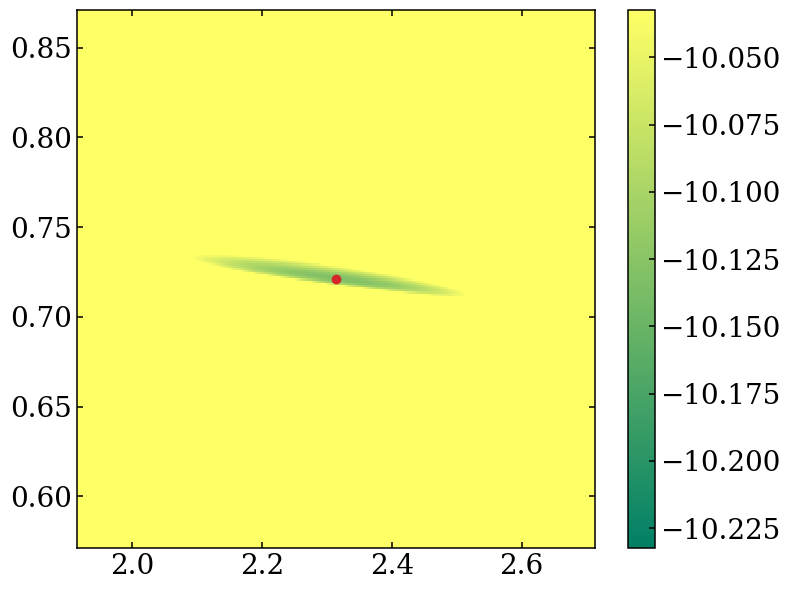

In [10]:
fig, ax = create_fig(1, 1)
ax = ax[0]

im = ax.pcolormesh(ro_mesh, to_mesh, mu, vmin=mu_min-0.1, vmax=mu_min+0.1, cmap='summer')
ax.scatter(rs_min, rc_min, color='C3')
plt.colorbar(im)


In [16]:
index = np.where(mu == np.amin(mu))
print(index)
print(r_out[index[0]])
print(t_out[index[1]])
print(rs_min, rc_min)
print(np.amin(mu))
print(mu_min)
# objective function from publication is -10.27 -- constant offset of 0.14 kT

(array([500]), array([496]))
[2.31447396]
[0.71998938]
2.314073562541468 0.7210404350930327
-10.132379428063423
-10.132397082357217


In [24]:
mic = micelle.BilayerVesicle.optimised_radii(200, 298, 8, throw_errors=False)

r_outer = mic.radius_outer
t_outer = mic.thickness_outer
n = 250
dr = 0.4
dt = 0.15
r_out = np.linspace(r_outer - dr, r_outer + dr, n)
t_out = np.linspace(t_outer - dt, t_outer + dt, n)

mu = np.zeros((n, n))

for i, roi in enumerate(r_out):
    mic._r_out = roi
    for ii, toi in enumerate(t_out):
        mic._t_out = toi
        
        mui = mic.get_interface_free_energy()
       
        mu[i, ii] = mui

ro_mesh, to_mesh = np.meshgrid(r_out, t_out)

mic.optimise_radii()
rs_min = mic.radius_outer
rc_min = mic.thickness_outer
mu_min = mic.get_interface_free_energy()


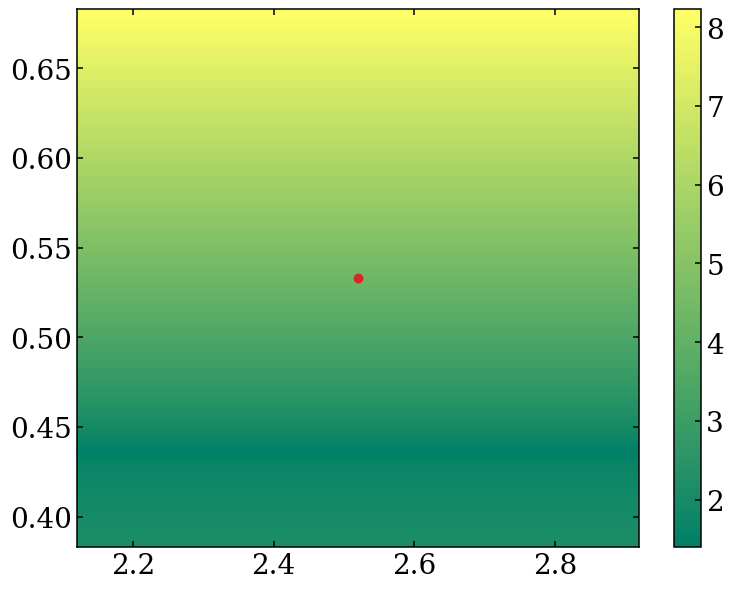

In [26]:

fig, ax = create_fig(1, 1)
ax = ax[0]

im = ax.pcolormesh(ro_mesh, to_mesh, mu, cmap='summer')
ax.scatter(rs_min, rc_min, color='C3')
plt.colorbar(im)


In [110]:
# r_out & t_out
# so much complicated for so little result
dx = 0.1
dxx = 0.99
index = np.where(np.absolute(mu - np.ones(mu.shape)*mu_min) < dx)
for i in range(1000):
    shape = np.unique(index[0]).shape[0]
    if shape > 2.1:
        dx *= dxx
        index = np.where(np.absolute(mu - np.ones(mu.shape)*mu_min) < dx)
    elif shape < 0.0:
        dx /= dxx
        dxx *= 0.01
        index = np.where(np.absolute(mu - np.ones(mu.shape)*mu_min) < dx)
    else:
        break

t_out = t_out[np.where(index[0] == index[0][0])]
print(t_out)

[0.38299822 0.38420304 0.38540786 0.38661268 0.3878175  0.38902232
 0.39022714 0.39143196 0.39263678 0.3938416  0.39504641 0.39625123
 0.39745605 0.39866087 0.39986569 0.40107051 0.40227533 0.40348015
 0.40468497 0.40588979 0.40709461 0.40829943 0.40950425 0.41070907
 0.41191388 0.4131187  0.41432352 0.41552834 0.41673316 0.41793798
 0.4191428  0.42034762 0.42155244 0.42275726 0.42396208 0.4251669
 0.42637172 0.42757654 0.42878135 0.42998617 0.43119099 0.43239581
 0.43360063 0.43480545 0.43601027 0.43721509 0.43841991 0.43962473
 0.44082955 0.44203437 0.44323919 0.44444401 0.44564882 0.44685364
 0.44805846 0.44926328 0.4504681  0.45167292 0.45287774 0.45408256
 0.45528738 0.4564922  0.45769702 0.45890184 0.46010666 0.46131147
 0.46251629 0.46372111 0.46492593 0.46613075 0.46733557 0.46854039
 0.46974521 0.47095003 0.47215485 0.47335967 0.47456449 0.47576931
 0.47697413 0.47817894 0.47938376 0.48058858 0.4817934  0.48299822
 0.48420304 0.48540786 0.48661268 0.4878175  0.48902232 0.49022

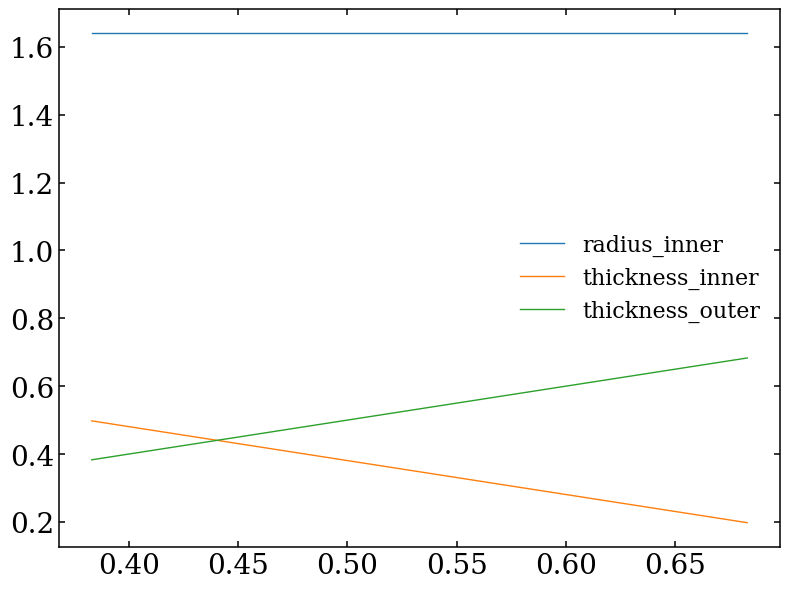

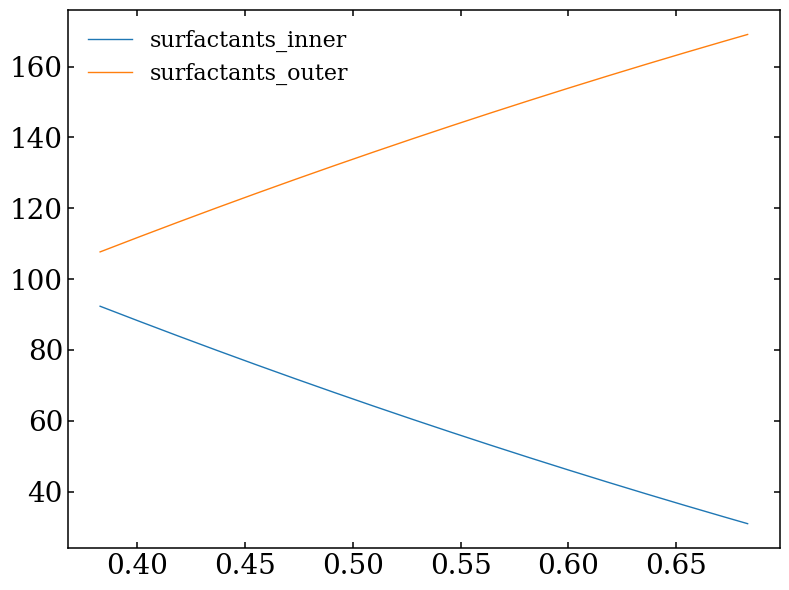

In [123]:
r_out_index = np.unique(index[0])
r_outer = r_out[r_out_index[0]]/2. + r_out[r_out_index[1]]/2.

def plot_prop(mic, mic_fun, r_outer, t_outer, **kwargs):
    fig, ax = create_fig(1, 1)
    ax = ax[0]
    prop = np.zeros(t_outer.shape)
    mic._r_out = r_outer
    for mic_fun_i in mic_fun:
        for i, t_outi in enumerate(t_outer):
            mic._t_out = t_outi
            prop[i] = mic_fun_i(mic)
        ax.plot(t_outer, prop)
    
    ax.set_ylim(kwargs.pop('ylim', ax.get_ylim()))
    ax.legend(kwargs.pop('labels', []))


mic = micelle.BilayerVesicle(200, 298, 8, throw_errors=False)
plot_prop(mic, [lambda x : x.radius_inner, lambda x : x.thickness_inner, lambda x: x.thickness_outer], r_outer, t_out, 
labels=['radius_inner', 'thickness_inner', 'thickness_outer'])
plot_prop(mic, [lambda x : x.surfactants_number_inner, lambda x : x.surfactants_number_outer], r_outer, t_out, labels=['surfactants_inner', 'surfactants_outer'])

/Users/matthias/CODE/MT_micellization/MTM/micelles/bilayer_vesicle.py:176: RuntimeWarning: invalid value encountered in log
  _ln = np.log(1.0 - a_head / a_avail)


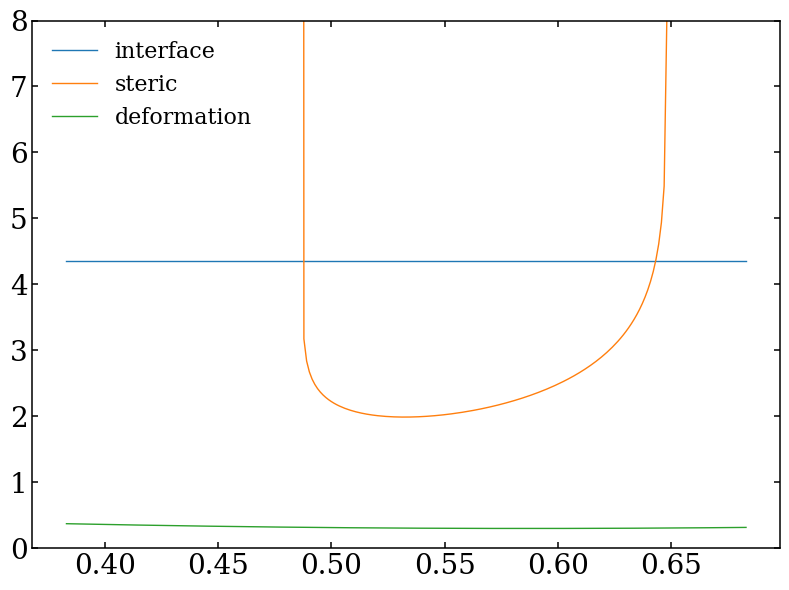

In [124]:
plot_prop(mic, [lambda x : x.get_interface_free_energy(), lambda x : x.get_steric_free_energy(), lambda x: x.get_deformation_free_energy()], r_outer, t_out, ylim=(0, 8), labels=['interface', 'steric', 'deformation'])